In [54]:
!pip install opendatasets

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [55]:
!pip install category_encoders

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# Import

In [56]:
import opendatasets as od
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
import seaborn as sns 
import missingno as msno
import random
import numpy as np 

from category_encoders import BinaryEncoder

# Download 

In [57]:
# {"username":"hauth7201","key":"3057ff45efdd5847796be879573f826c"}

path = 'https://www.kaggle.com/datasets/vanviethieuanh/vietnam-weather-data?fbclid=IwAR0I9LPl9GcBESRcLgMkufchT0TD_0pf8vlPzk-qRxcNdvVFUrGeTj28CIM'
od.download(path)

Skipping, found downloaded files in "./vietnam-weather-data" (use force=True to force download)


In [58]:
path = '/content/vietnam-weather-data/weather.csv'
df = pd.read_csv(path)

In [59]:
number_of_row = len(df)
print('Number of row:', number_of_row)

Number of row: 181960


# Noising data

In [60]:
df['date'] = pd.to_datetime(df['date'])
df = df.sort_values(['province', 'date'], ignore_index=True)

In [61]:
def noising_data(df, column, frac, value):
  amount = int(number_of_row*frac)

  # index list of sample
  indices = np.random.choice(range(number_of_row), size=amount, replace=False)

  # Change value
  df.loc[indices, column] = value

Add noise to feature

In [62]:
noising_data(df, 'wind_d', 0.1, None)

In [63]:
noising_data(df, 'max', 0.01, None)

In [64]:
noising_data(df, 'humidi', 0.05, None)

# Statistic

In [65]:
numerical_feature = ['max', 'min', 'wind', 'rain', 'humidi', 'cloud', 'pressure']
nominal_feature = ['province', 'wind_d']
time_series_feature = ['date']

In [66]:
provinces = df['province'].unique()
print('Number of provinces:', len(provinces))
print('\nData:\n', provinces)

Number of provinces: 40

Data:
 ['Bac Lieu' 'Ben Tre' 'Bien Hoa' 'Buon Me Thuot' 'Ca Mau' 'Cam Pha'
 'Cam Ranh' 'Can Tho' 'Chau Doc' 'Da Lat' 'Ha Noi' 'Hai Duong' 'Hai Phong'
 'Hanoi' 'Ho Chi Minh City' 'Hoa Binh' 'Hong Gai' 'Hue' 'Long Xuyen'
 'My Tho' 'Nam Dinh' 'Nha Trang' 'Phan Rang' 'Phan Thiet' 'Play Cu'
 'Qui Nhon' 'Rach Gia' 'Soc Trang' 'Tam Ky' 'Tan An' 'Thai Nguyen'
 'Thanh Hoa' 'Tra Vinh' 'Tuy Hoa' 'Uong Bi' 'Viet Tri' 'Vinh' 'Vinh Long'
 'Vung Tau' 'Yen Bai']


In [67]:
wind_d = df['wind_d'].unique()
print('Number of wind direction:', len(wind_d))
print('\nData:\n', wind_d)

Number of wind direction: 17

Data:
 ['NNE' 'ENE' 'ESE' 'E' 'SE' None 'S' 'SSW' 'SSE' 'SW' 'WSW' 'W' 'WNW' 'NW'
 'NE' 'N' 'NNW']


In [68]:
df.describe()

,max,min,wind,rain,humidi,cloud,pressure
count,180141.000000,181960.000000,181960.000000,181960.000000,172862.000000,181960.000000,181960.000000
mean,29.835718,23.277874,11.038657,6.567130,77.084212,41.721268,1010.229127
std,4.572365,3.945381,5.311807,13.602055,9.286312,23.875067,4.635714
min,4.000000,2.000000,1.000000,0.000000,23.000000,0.000000,988.000000
25%,28.000000,21.000000,7.000000,0.100000,71.000000,23.000000,1008.000000
50%,31.000000,24.000000,10.000000,1.800000,78.000000,38.000000,1010.000000
75%,33.000000,26.000000,14.000000,7.500000,83.000000,58.000000,1012.000000
max,46.000000,32.000000,54.000000,596.400000,100.000000,100.000000,1038.000000


In [69]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181960 entries, 0 to 181959
Data columns (total 10 columns):
 #   Column    Non-Null Count   Dtype         
---  ------    --------------   -----         
 0   province  181960 non-null  object        
 1   max       180141 non-null  float64       
 2   min       181960 non-null  int64         
 3   wind      181960 non-null  int64         
 4   wind_d    163764 non-null  object        
 5   rain      181960 non-null  float64       
 6   humidi    172862 non-null  float64       
 7   cloud     181960 non-null  int64         
 8   pressure  181960 non-null  int64         
 9   date      181960 non-null  datetime64[ns]
dtypes: datetime64[ns](1), float64(3), int64(4), object(2)
memory usage: 13.9+ MB


<Axes: >

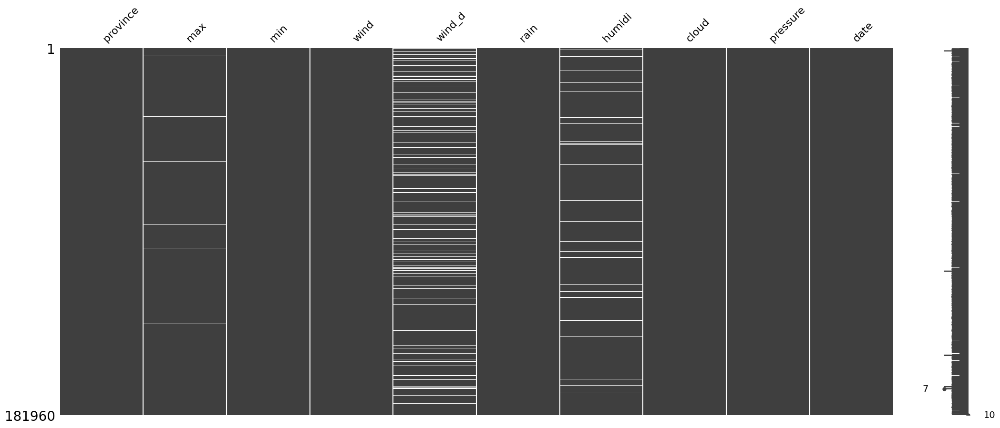

In [70]:
# Check null/missing valaue
msno.matrix(df)

In [71]:
# Save nosing data
path = "nosing_data.csv"
df.to_csv(path)

# Visualize

In [72]:
def create_logical_array(size, index):
    logical_array = np.full(size, False)
    
    logical_array[index] = True
    
    return logical_array.tolist()

Nominal feature 

In [73]:
# win_d histogram plot

fig = go.Figure()

num_province = len(provinces)

button_list = list([
    dict(label = 'All',
         method = 'update',
         args = [{'visible': [True]*num_province},
          {'showlegend':True}])
    ])

for i in range(num_province):
    fig.add_trace(
        go.Histogram(x=df[df['province']==provinces[i]]['wind_d'],
                     name=provinces[i])
    )

    button_list.append(
        dict(label = provinces[i],
             method = 'update',
             args = [{'visible': create_logical_array(num_province, i)},
              {'showlegend':True}])
    )
    
fig.update_layout(
    updatemenus=[go.layout.Updatemenu(
        active=0,
        buttons=button_list
        )
    ])

fig.show()

In [74]:
# wind_d count

df_wind = df.groupby('province')['wind_d'].value_counts().unstack()
df_wind

wind_d,E,ENE,ESE,N,NE,NNE,NNW,NW,S,SE,SSE,SSW,SW,W,WNW,WSW
province,,,,,,,,,,,,,,,,
Bac Lieu,895.0,418.0,472.0,1.0,35.0,6.0,6.0,9.0,119.0,206.0,148.0,180.0,450.0,304.0,44.0,789.0
Ben Tre,590.0,171.0,747.0,NaN,24.0,8.0,6.0,21.0,165.0,376.0,213.0,238.0,488.0,196.0,53.0,788.0
Bien Hoa,360.0,149.0,557.0,NaN,36.0,12.0,7.0,22.0,243.0,634.0,378.0,305.0,491.0,207.0,65.0,638.0
Buon Me Thuot,743.0,1168.0,112.0,NaN,55.0,1.0,NaN,NaN,149.0,72.0,109.0,408.0,852.0,44.0,14.0,364.0
Ca Mau,792.0,398.0,482.0,NaN,85.0,37.0,1.0,4.0,127.0,204.0,151.0,208.0,406.0,361.0,78.0,723.0
Cam Pha,424.0,840.0,364.0,6.0,691.0,171.0,3.0,6.0,487.0,307.0,318.0,218.0,127.0,21.0,19.0,79.0
Cam Ranh,155.0,213.0,209.0,98.0,133.0,674.0,5.0,11.0,425.0,268.0,302.0,743.0,680.0,30.0,6.0,129.0
Can Tho,618.0,198.0,720.0,2.0,44.0,17.0,2.0,14.0,141.0,324.0,209.0,227.0,498.0,195.0,33.0,846.0
Chau Doc,209.0,177.0,345.0,2.0,103.0,129.0,5.0,10.0,295.0,488.0,406.0,366.0,661.0,139.0,33.0,735.0


Numerical feature

In [75]:
# selected province

plot_province = 'Bac Lieu'
df_p = df[df['province']==plot_province]
df_p = df_p.sort_values(['province', 'date'])

In [76]:
df_p

,province,max,min,wind,wind_d,rain,humidi,cloud,pressure,date
0,Bac Lieu,27.0,22,17,NNE,6.9,90.0,71,1010,2009-01-01
1,Bac Lieu,28.0,22,15,ENE,0.5,85.0,61,1010,2009-01-02
2,Bac Lieu,23.0,21,9,ESE,16.7,91.0,77,1011,2009-01-03
3,Bac Lieu,27.0,21,9,E,2.2,86.0,32,1011,2009-01-04
4,Bac Lieu,29.0,22,10,SE,0.0,81.0,25,1010,2009-01-05
...,...,...,...,...,...,...,...,...,...,...
4544,Bac Lieu,33.0,26,11,SSW,1.5,71.0,48,1009,2021-06-14
4545,Bac Lieu,31.0,26,12,W,1.3,75.0,43,1008,2021-06-15
4546,Bac Lieu,34.0,26,11,WSW,3.7,74.0,48,1009,2021-06-16
4547,Bac Lieu,33.0,27,14,W,0.5,69.0,45,1009,2021-06-17


In [77]:
# Scatter plot

fig = go.Figure()

num_feature = len(numerical_feature)

button_list = list(
            [dict(label = 'All',
                  method = 'update',
                  args = [{'visible': [True]*num_feature},
                          {'showlegend':True}])
            ])

for i in range(num_feature):
    fig.add_trace(
        go.Scatter(
            x = df_p.date,
            y = df_p[numerical_feature[i]],
            name = numerical_feature[i]
        )
    )

    button_list.append(
        dict(label = numerical_feature[i],
             method = 'update',
             args = [{'visible': create_logical_array(num_feature, i)},
              {'showlegend':True}])
    )
    
fig.update_layout(
    updatemenus=[go.layout.Updatemenu(
        active=0,
        buttons=button_list
        )
    ])

fig.show()

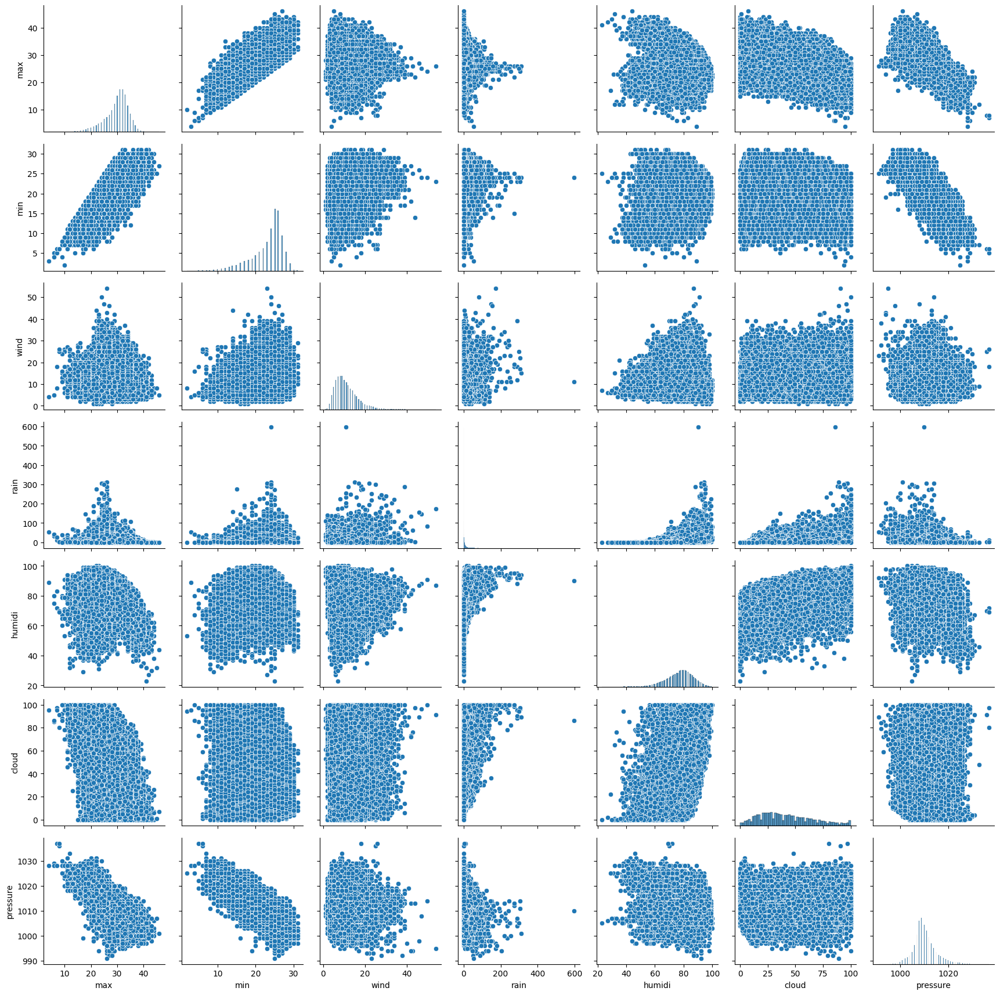

In [78]:
# Scatter matrix plot

g = sns.PairGrid(df.sample(frac=0.3))
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

In [113]:
# box plot

fig = go.Figure()

num_feature = len(numerical_feature)

button_list = list([])

for i in range(num_feature):
  fig.add_trace(
      go.Box(x = df['province'],
             y=df[numerical_feature[i]],
             name = numerical_feature[i])             
      )
  
  button_list.append(
      dict(label = numerical_feature[i],
           method = 'update',
           args = [{'visible': create_logical_array(num_feature, i)}]
           )
      )
    
fig.update_layout(
    updatemenus=[go.layout.Updatemenu(
        active=0,
        buttons=button_list,
        y=1
        )
    ])

fig.show()

In [114]:
# outliers count

Q1 = df[numerical_feature].quantile(0.25)
Q3 = df[numerical_feature].quantile(0.75)
IQR = Q3 - Q1

In [ ]:
df_outliers = df[['province']+numerical_feature]

grouped = df_outliers.groupby('province')

outliers_count = grouped.apply(lambda x: ((x < (Q1 - 1.5 * IQR)) | (x > (Q3 + 1.5 * IQR))).sum()).drop('province', axis=1)

In [82]:
outliers_count

,cloud,humidi,max,min,pressure,rain,wind
province,,,,,,,
Bac Lieu,0,1,0,0,0,91,209
Ben Tre,0,6,1,0,0,45,13
Bien Hoa,0,64,1,0,0,582,1
Buon Me Thuot,0,56,23,29,9,650,0
Ca Mau,0,0,0,0,0,285,176
Cam Pha,0,81,845,253,1053,534,105
Cam Ranh,0,0,0,0,6,460,687
Can Tho,0,7,0,0,0,74,18
Chau Doc,0,46,0,0,0,404,11


In [108]:
print("Total outliers:\n")
print('Total:', sum(outliers_count.sum()))
print()

feature_outlier_number = outliers_count.sum()
outliers_value_df = pd.DataFrame({'column name': feature_outlier_number.index,
                                 'number of outlier': feature_outlier_number.values,
                                 'percent of outlier': feature_outlier_number.values * 100 / len(df)})

outliers_value_df['percent of outlier'] = outliers_value_df['percent of outlier'].round(decimals=2)
outliers_value_df

Total outliers:


Total: 51544


,column name,number of outlier,percent of outlier
0,cloud,0,0.00
1,humidi,1929,1.06
2,max,8503,4.67
3,min,5200,2.86
4,pressure,14552,8.00
5,rain,17147,9.42
6,wind,4213,2.32


In [105]:
outliers_count.sum().values

array([    0,  1929,  8503,  5200, 14552, 17147,  4213])

Correlation 

<ipython-input-84-74a3f1691aa2>:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



<Axes: >

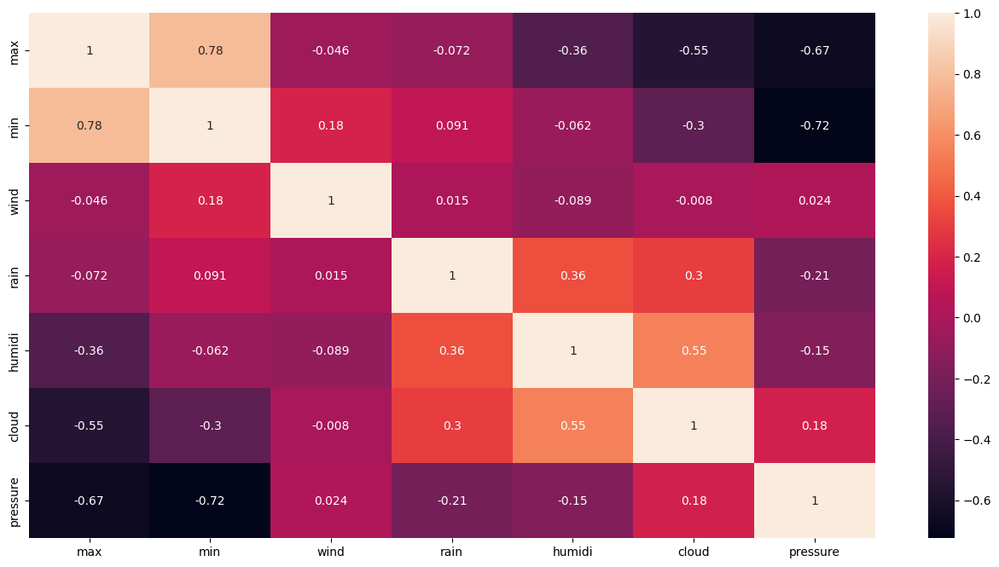

In [84]:
plt.figure(figsize=(16, 8))
corr = df.corr()
sns.heatmap(corr, annot=True)

# Preprocessing 

Missing value

<Axes: >

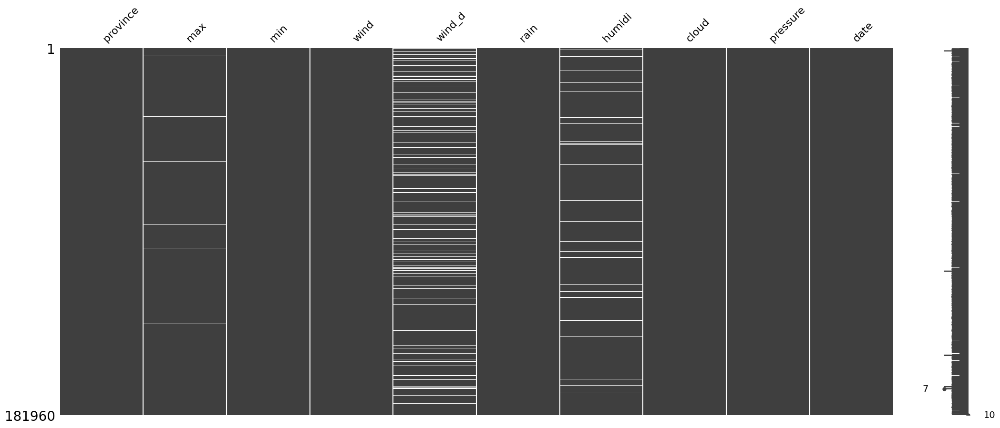

In [85]:
# Check missing value

msno.matrix(df)

In [86]:
missing_feature = ['max', 'wind_d', 'humidi']

In [110]:
percent_missing = df[missing_feature].isnull().sum()
missing_value_df = pd.DataFrame({'column name': missing_feature,
                                 'number of null': percent_missing,
                                 'percent of missing': percent_missing * 100 / len(df)})

missing_value_df['percent of missing'] = missing_value_df['percent of missing'].round(decimals=2)
missing_value_df

,column name,number of null,percent of missing
max,max,0,0.0
wind_d,wind_d,0,0.0
humidi,humidi,0,0.0


In [88]:
df[:10]

,province,max,min,wind,wind_d,rain,humidi,cloud,pressure,date
0,Bac Lieu,27.0,22,17,NNE,6.9,90.0,71,1010,2009-01-01
1,Bac Lieu,28.0,22,15,ENE,0.5,85.0,61,1010,2009-01-02
2,Bac Lieu,23.0,21,9,ESE,16.7,91.0,77,1011,2009-01-03
3,Bac Lieu,27.0,21,9,E,2.2,86.0,32,1011,2009-01-04
4,Bac Lieu,29.0,22,10,SE,0.0,81.0,25,1010,2009-01-05
5,Bac Lieu,30.0,23,10,E,0.3,81.0,25,1011,2009-01-06
6,Bac Lieu,29.0,24,12,ESE,1.9,83.0,30,1012,2009-01-07
7,Bac Lieu,29.0,22,10,None,1.2,81.0,40,1013,2009-01-08
8,Bac Lieu,28.0,21,12,ENE,0.0,74.0,26,1014,2009-01-09
9,Bac Lieu,26.0,18,14,E,0.0,69.0,16,1014,2009-01-10


In [89]:
# Fill max feature

df['max'] = df['max'].bfill()

In [90]:
# Fill wind_d feature 

df['wind_d'] = df['wind_d'].bfill()

In [91]:
# Fill humidi feature

df['humidi'] = df['humidi'].interpolate()

Categorical encoding

In [92]:
created_feature = []

In [93]:
# Encode rain feature 

mean_rain_by_province = df.groupby('province')['rain'].mean()

In [94]:
df['province_encoded'] = df['province'].map(mean_rain_by_province)

In [95]:
created_feature.append('province_encoded')

In [96]:
df.head()

,province,max,min,wind,wind_d,rain,humidi,cloud,pressure,date,province_encoded
0,Bac Lieu,27.0,22,17,NNE,6.9,90.0,71,1010,2009-01-01,3.455858
1,Bac Lieu,28.0,22,15,ENE,0.5,85.0,61,1010,2009-01-02,3.455858
2,Bac Lieu,23.0,21,9,ESE,16.7,91.0,77,1011,2009-01-03,3.455858
3,Bac Lieu,27.0,21,9,E,2.2,86.0,32,1011,2009-01-04,3.455858
4,Bac Lieu,29.0,22,10,SE,0.0,81.0,25,1010,2009-01-05,3.455858


In [97]:
# Encode wind feature

encoder = BinaryEncoder(cols=['wind_d'])
df_encoded = encoder.fit_transform(df)
df_encoded

,province,max,min,wind,wind_d_0,wind_d_1,wind_d_2,wind_d_3,wind_d_4,rain,humidi,cloud,pressure,date,province_encoded
0,Bac Lieu,27.0,22,17,0,0,0,0,1,6.9,90.0,71,1010,2009-01-01,3.455858
1,Bac Lieu,28.0,22,15,0,0,0,1,0,0.5,85.0,61,1010,2009-01-02,3.455858
2,Bac Lieu,23.0,21,9,0,0,0,1,1,16.7,91.0,77,1011,2009-01-03,3.455858
3,Bac Lieu,27.0,21,9,0,0,1,0,0,2.2,86.0,32,1011,2009-01-04,3.455858
4,Bac Lieu,29.0,22,10,0,0,1,0,1,0.0,81.0,25,1010,2009-01-05,3.455858
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181955,Yen Bai,32.0,23,6,0,0,0,1,1,7.3,79.0,71,1001,2021-06-14,9.170103
181956,Yen Bai,34.0,25,6,0,1,0,0,0,0.3,71.0,46,999,2021-06-15,9.170103
181957,Yen Bai,36.0,27,6,0,1,0,0,1,0.0,64.0,29,1000,2021-06-16,9.170103
181958,Yen Bai,37.0,28,7,0,0,1,1,0,0.0,66.0,27,1002,2021-06-17,9.170103


In [98]:
binary_wind_d_feature = ['wind_d_0',	'wind_d_1',	'wind_d_2',	'wind_d_3',	'wind_d_4']
created_feature = created_feature + binary_wind_d_feature